<a href="https://colab.research.google.com/github/KithminiP/KithminiP/blob/main/Analysis_of_business_volume_of_Chrisco.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install hvplot

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.2/3.2 MB 22.5 MB/s eta 0:00:00


In [ ]:
!pip install -U matplotlib pandas

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.4/12.4 MB 59.9 MB/s eta 0:00:00
  Attempting uninstall: pandas
    Found existing installation: pandas 1.4.4
    Uninstalling pandas-1.4.4:
      Successfully uninstalled pandas-1.4.4
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
db-dtypes 1.0.5 requires pandas<2.0dev,>=0.24.2, but you have pandas 2.0.0 which is incompatible.


In [ ]:
!pip install --upgrade hvplot panel bokeh ipykernel holoviews ipywidgets

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.3/8.3 MB 50.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 150.0/150.0 KB 12.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 138.3/138.3 KB 13.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 39.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 32.4 MB/s eta 0:00:00
  Attempting uninstall: widgetsnbextension
    Found existing installation: widgetsnbextension 3.6.4
    Uninstalling widgetsnbextension-3.6.4:
      Successfully uninstalled widgetsnbextension-3.6.4
  Attempting uninstall: ipykernel
    Found existing installation: ipykernel 5.5.6
    Uninstalling ipykernel-5.5.6:
      Successfully uninstalled ipykernel-5.5.6
  Attempting uninstall: ipywidgets
    Found existing installation: ipywidgets 7.7.1
    Uninstalling ipywidgets-7.7.1:
      Successfully

Creating two dataframes:  one containing daily customer data (one row for each
date); the other containing summary data (one row for each outlet), compiled from all of the .csv files,
including the daily visitors

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd
from statsmodels.tsa.seasonal import seasonal_decompose
import hvplot.pandas
import numpy as np
import seaborn as sns
import panel as pn
import holoviews as hv
import panel as pn
from sklearn.cluster import KMeans
from mpl_toolkits.mplot3d import Axes3D

#pn.extension()

pn.extension(comms='colab')



data = pd.read_csv('https://raw.githubusercontent.com/ChrisWalshaw/DataViz/master/Data/001281690/OutletDailyCustomers.csv', index_col=0)
selected = ['ZYT', 'ZMY','AGN','YMQ','ZSJ','XSB']
data.index = pd.to_datetime(data.index)

print(data)
print(data.head())
print(data.tail())
print(data.describe())
print(data.sum())

            MZO  HTF  LTU  XSB   RAN  QZF  YMQ  NLT  AYD  CTH  ...  CGV  NFH   
Date                                                           ...             
2021-01-01   65   94   79    0  2329   69    0   67    0   67  ...  764   78  \
2021-01-02   74  106   73    0  2162   81    0   63    0   59  ...  743   97   
2021-01-03   58   86   91    0  1802   65    0   74    0   52  ...  650   48   
2021-01-04   70   76   76    0  2509   77    0   66    0   85  ...  583  113   
2021-01-05   69   84   78    0  1214   63    0   51    0   63  ...  581   95   
...         ...  ...  ...  ...   ...  ...  ...  ...  ...  ...  ...  ...  ...   
2021-12-27   69    0   63   47  1264   63  139   72  118   61  ...  656   81   
2021-12-28   71    0   77   90   836   79  118   76   74   67  ...  646   66   
2021-12-29   73    0   89   70  2045   79   53   63  207   69  ...  714   72   
2021-12-30   71    0   89   72  1707   79   77   84   98   73  ...  814   98   
2021-12-31   66    0   82   80  2234   7

In [ ]:
#data = pd.read_csv('https://raw.githubusercontent.com/ChrisWalshaw/DataViz/master/Data/001281690/OutletDailyCustomers.csv', index_col=0)

outlet_marketing_data = pd.read_csv('https://raw.githubusercontent.com/ChrisWalshaw/DataViz/master/Data/001281690/OutletMarketing.csv', index_col=0)
outlet_overheads_data = pd.read_csv('https://raw.githubusercontent.com/ChrisWalshaw/DataViz/master/Data/001281690/OutletOverheads.csv', index_col=0)
outlet_size_data = pd.read_csv('https://raw.githubusercontent.com/ChrisWalshaw/DataViz/master/Data/001281690/OutletSize.csv', index_col=0)
outlet_staff_data = pd.read_csv('https://raw.githubusercontent.com/ChrisWalshaw/DataViz/master/Data/001281690/OutletStaff.csv', index_col=0)

summary_data = pd.DataFrame(index=data.columns)
summary_data['Marketing'] = outlet_marketing_data.values
summary_data['Overheads'] = outlet_overheads_data.values
summary_data['Size'] = outlet_size_data.values
summary_data['Staff'] = outlet_staff_data.values
summary_data['Customers'] = data.sum().values

print(summary_data.head())
print(summary_data.describe())

     Marketing  Overheads  Size  Staff  Customers
MZO       3000      89000   109      2      25004
HTF       2000      94000    54      1      16059
LTU       4000      28000   134      2      28456
XSB       2000      68000    66      1      10952
RAN      89000      15000  2125     19     743119
          Marketing     Overheads         Size      Staff      Customers
count     45.000000     45.000000    45.000000  45.000000      45.000000
mean   11133.333333  51844.444444   708.355556   6.800000  111044.155556
std    18750.272725  23708.413884  1287.297012  11.968899  187663.383359
min     1000.000000  15000.000000    15.000000   1.000000    4055.000000
25%     3000.000000  31000.000000   109.000000   1.000000   22450.000000
50%     3000.000000  53000.000000   139.000000   2.000000   26968.000000
75%     4000.000000  69000.000000   253.000000   3.000000   33210.000000
max    89000.000000  94000.000000  5580.000000  60.000000  743119.000000


High volume outlets: RAN, RFY, DMN

medium volume outlets: DSA, EYS, EEC, BMF, BSQ, CYK, CGV

Low volume outlets:ZYT, ZMY,AGN,YMQ,ZSJ, XSB

In [ ]:
# sort the data according to the sum of each column, largest first
data = data.reindex(data.sum().sort_values(ascending=False).index, axis=1)
print(data.sum())
print(data.head())

RAN    743119
RFY    675084
DMN    644362
DSA    345090
EYS    342855
EEC    325604
BMF    306930
BSQ    283688
CYK    276593
CGV    258623
OZW     34430
END     33210
DHJ     32222
PLB     32221
NFH     31905
FZI     30300
LLK     30129
OTL     30114
IFI     29644
DTO     29058
LTU     28456
EHT     27567
GNL     26968
QZF     26648
PFQ     26299
FTW     26260
CNW     25331
MZO     25004
NLT     24763
HZQ     24153
CTH     23884
GFA     22812
DZZ     22759
MTE     22450
AYD     17640
HNV     17432
YGE     16429
HTF     16059
IZX     15574
XSB     10952
ZSJ      9805
YMQ      7766
ZYT      6461
ZMY      6279
AGN      4055
dtype: int64
             RAN   RFY   DMN   DSA   EYS   EEC   BMF  BSQ  CYK  CGV  ...  HNV   
Date                                                                 ...        
2021-01-01  2329  1997  2563   711  1050  1007  1040  825  843  764  ...   61  \
2021-01-02  2162  1962  1917  1101  1012   905   844  908  795  743  ...   64   
2021-01-03  1802  1789  2062   83

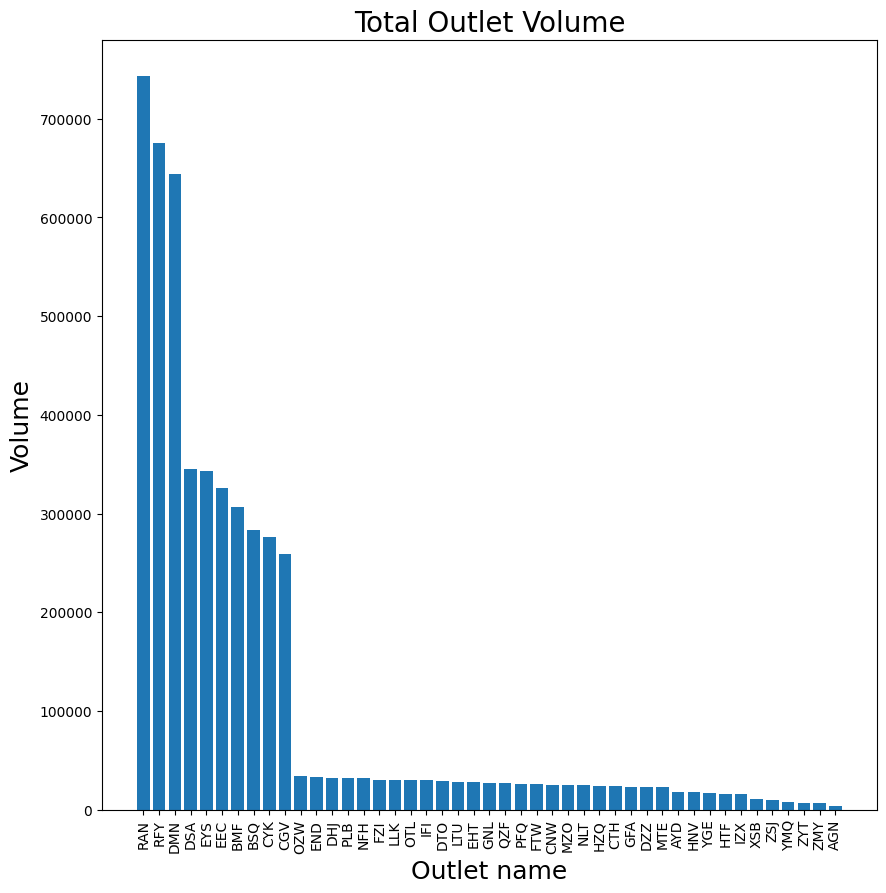

In [ ]:
plt.figure(figsize=(10, 10))
x_pos = np.arange(len(data.columns))
plt.bar(x_pos, data.sum(), align='center')
plt.xticks(x_pos, data.columns,rotation=90)
plt.xlabel('Outlet name', fontsize=18)
plt.ylabel('Volume', fontsize=18)
plt.title('Total Outlet Volume', fontsize=20)
plt.show()

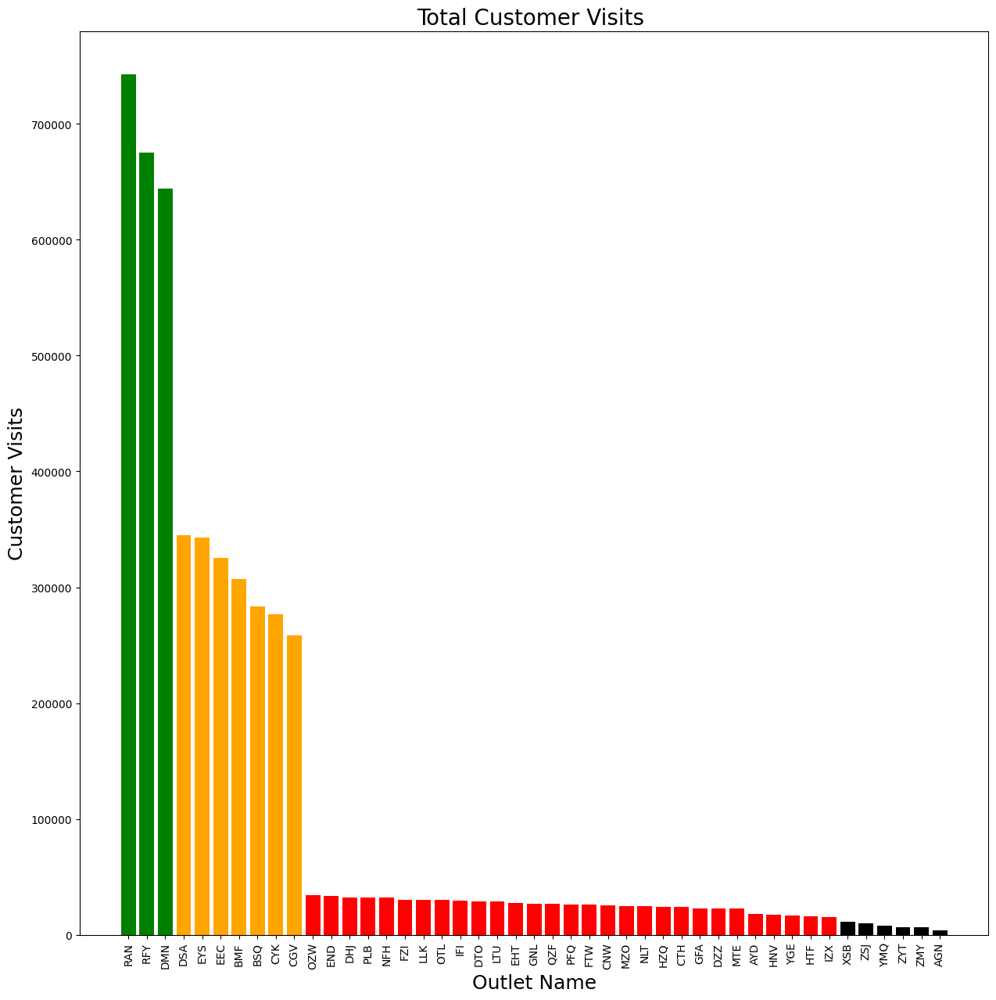

In [ ]:
colours = []
for name in data.columns:
    total_visits = data[name].sum()
    if total_visits > 500000:
        colour = 'green'
    elif total_visits > 100000:
        colour = 'orange'
    elif total_visits > 11000:
        colour = 'red'
    else:
        colour = 'black'
    colours.append(colour)

plt.figure(figsize=(15,15))
x_pos = np.arange(len(data.columns))
plt.bar(x_pos, data.sum(), align='center', color=colours)
plt.xticks(x_pos, data.columns, rotation=90)
plt.xlabel('Outlet Name', fontsize=18)
plt.ylabel('Customer Visits', fontsize=18)
plt.title('Total Customer Visits ', fontsize=20)
plt.show()

High volume outlet

             RAN   RFY   DMN
Date                        
2021-01-01  2329  1997  2563
2021-01-02  2162  1962  1917
2021-01-03  1802  1789  2062
2021-01-04  2509  1663  1261
2021-01-05  1214  1658  1544


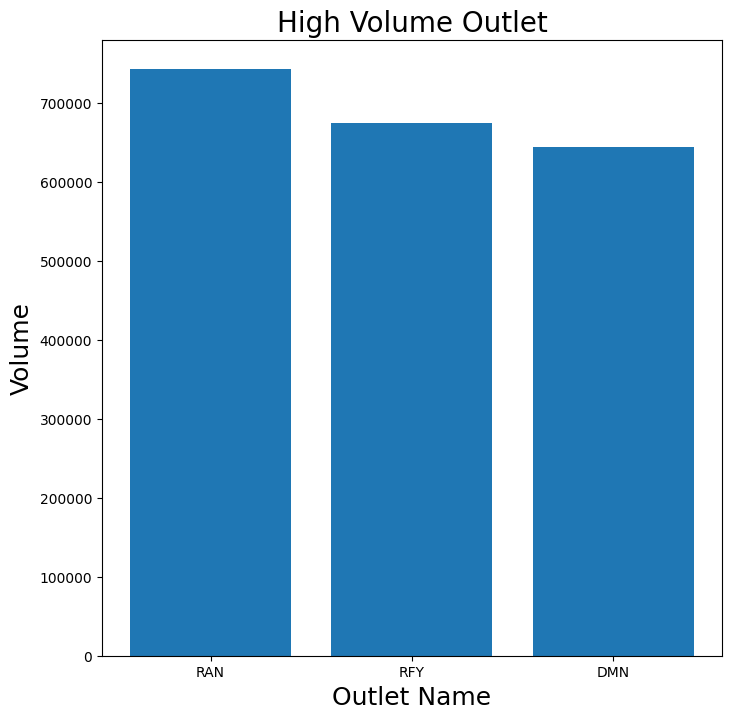

In [ ]:
selected = ['RAN', 'RFY', 'DMN']
print(data[selected].head())

# data[selected].sum().plot.bar(width=0.8, rot=0, figsize=(8, 8))
plt.figure(figsize=(8, 8))
x_pos = np.arange(len(data[selected].columns))
plt.bar(x_pos, data[selected].sum(), align='center')
plt.xticks(x_pos, data[selected].columns)
plt.xlabel('Outlet Name', fontsize=18)
plt.ylabel('Volume', fontsize=18)
plt.title('High Volume Outlet', fontsize=20)
plt.show()

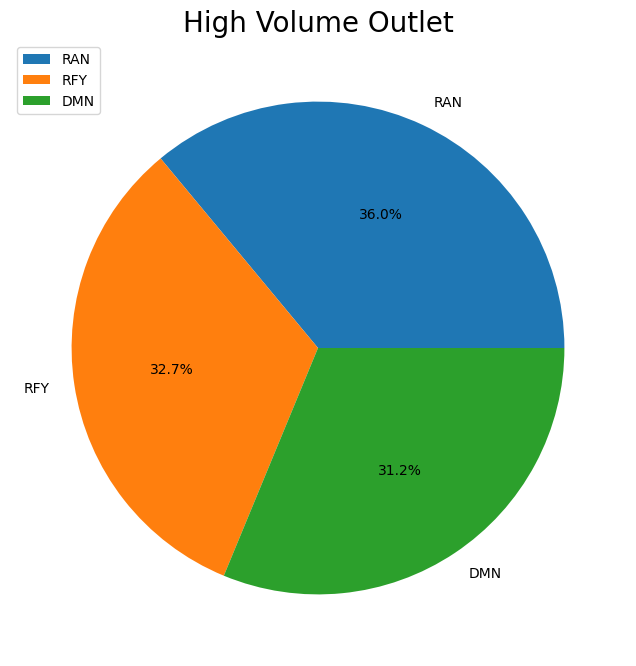

In [ ]:
high = ['RAN', 'RFY', 'DMN' ]
x=[]
columns = high
data['Others'] = [0] * len(data.index)
for name in columns:
    total_volume = data[name].sum()
    if total_volume > 600000:
        x.append(name)
    else:
        data['Others'] += data[name]
x.append('Others')

plt.figure(figsize=(8, 8))
plt.pie(data[high].sum(), labels=high,autopct='%1.1f%%')
plt.title('High Volume Outlet', fontsize=20)
#plt.pie(data[selected].sum(), labels=selected, autopct='%1.1f%%', startangle=90, explode=explodeList,colors =colours )
plt.legend(loc=2)
plt.show()

Medium volume

             DSA   EYS   EEC   BMF  BSQ  CYK  CGV
Date                                             
2021-01-01   711  1050  1007  1040  825  843  764
2021-01-02  1101  1012   905   844  908  795  743
2021-01-03   832   917   936   717  694  739  650
2021-01-04   900   866   812   614  744  629  583
2021-01-05   916   844   792   901  710  661  581


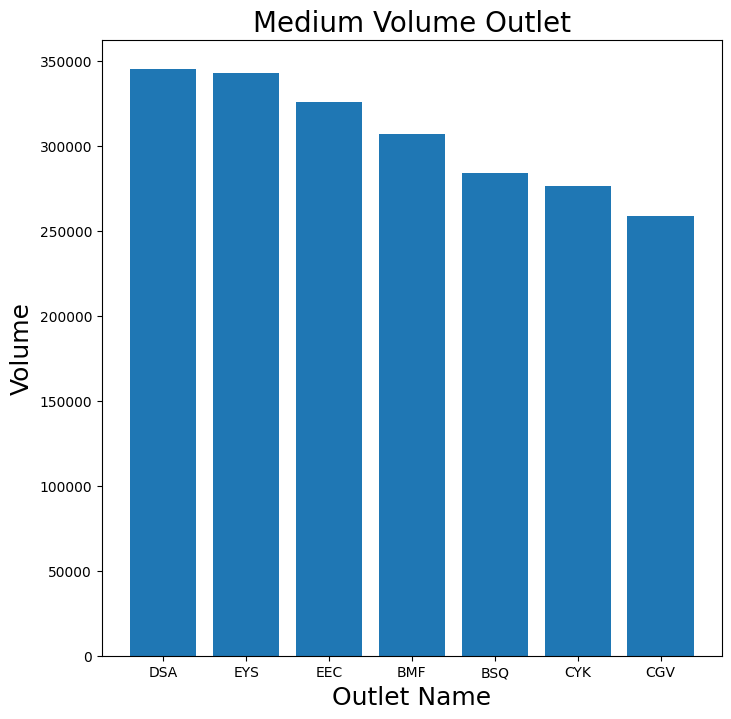

In [ ]:
medium = ['DSA', 'EYS', 'EEC', 'BMF', 'BSQ', 'CYK', 'CGV']
print(data[medium].head())

# data[selected].sum().plot.bar(width=0.8, rot=0, figsize=(8, 8))
plt.figure(figsize=(8, 8))
x_pos = np.arange(len(data[medium].columns))
plt.bar(x_pos, data[medium].sum(), align='center')
plt.xticks(x_pos, data[medium].columns)
plt.xlabel('Outlet Name', fontsize=18)
plt.ylabel('Volume', fontsize=18)
plt.title('Medium Volume Outlet', fontsize=20)
plt.show()


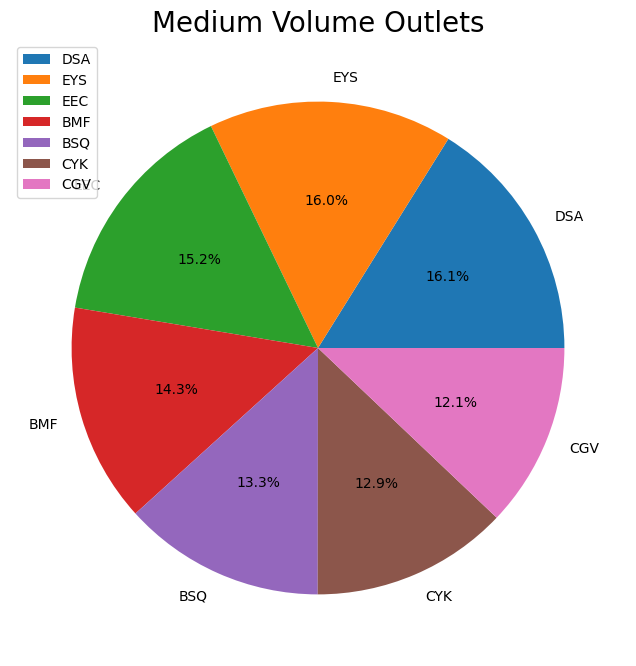

In [ ]:
medium = ['DSA', 'EYS', 'EEC', 'BMF', 'BSQ', 'CYK', 'CGV']
x=[]
columns = medium
data['Others'] = [0] * len(data.index)
for name in columns:
    total_volume = data[name].sum()
    if total_volume > 250000:
        x.append(name)
    else:
        data['Others'] += data[name]
x.append('Others')

plt.figure(figsize=(8, 8))
plt.pie(data[medium].sum(), labels=medium,autopct='%1.1f%%')
plt.title('Medium Volume Outlets', fontsize=20)
plt.legend(loc=2)
plt.show()

Very low volume

            ZYT  ZMY  AGN  YMQ  ZSJ  XSB
Date                                    
2021-01-01   53    0    0    0    0    0
2021-01-02   58    0    0    0    0    0
2021-01-03   67    0    0    0    0    0
2021-01-04   73    0    0    0    0    0
2021-01-05   68    0    0    0    0    0


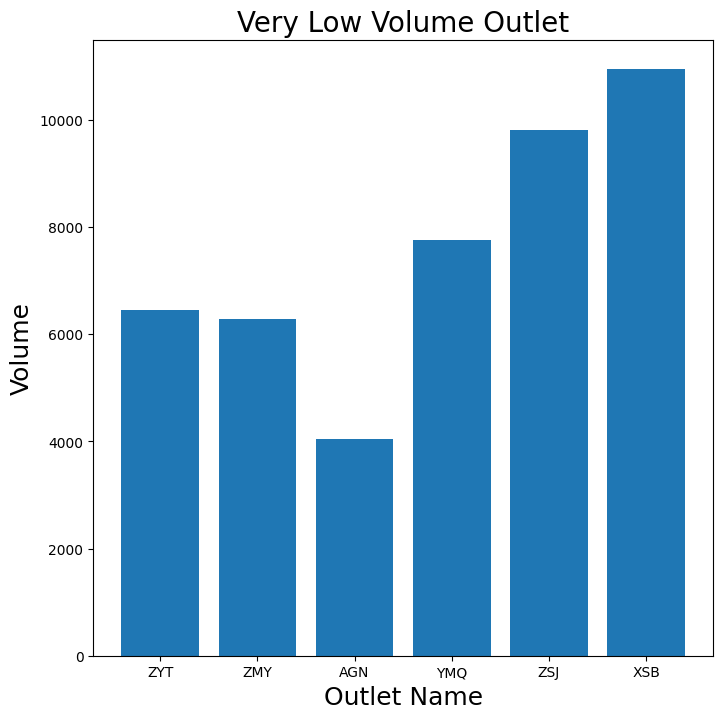

In [ ]:
verylow = ['ZYT', 'ZMY','AGN','YMQ','ZSJ','XSB']
print(data[verylow].head())

plt.figure(figsize=(8, 8))
x_pos = np.arange(len(data[verylow ].columns))
plt.bar(x_pos, data[verylow ].sum(), align='center')
plt.xticks(x_pos, data[verylow ].columns)
plt.xlabel('Outlet Name', fontsize=18)
plt.ylabel('Volume', fontsize=18)
plt.title('Very Low Volume Outlet', fontsize=20)
plt.show()


Line plot all

In [ ]:
def get_line_plot():
    return data.hvplot.line(frame_width=600, frame_height=600, grid=True)

In [ ]:
time_title = '## Time-Series'

time_row = pn.Row(
    pn.Column(time_title),
    get_line_plot()
)


time_row.servable()

Row
    [0] Column
        [0] Markdown(str)
    [1] HoloViews(NdOverlay, sizing_mode='fixed')

Line plot very low volume rolling averge

            ZYT  ZMY  AGN  YMQ  ZSJ  XSB
Date                                    
2021-01-01   53    0    0    0    0    0
2021-01-02   58    0    0    0    0    0
2021-01-03   67    0    0    0    0    0
2021-01-04   73    0    0    0    0    0
2021-01-05   68    0    0    0    0    0


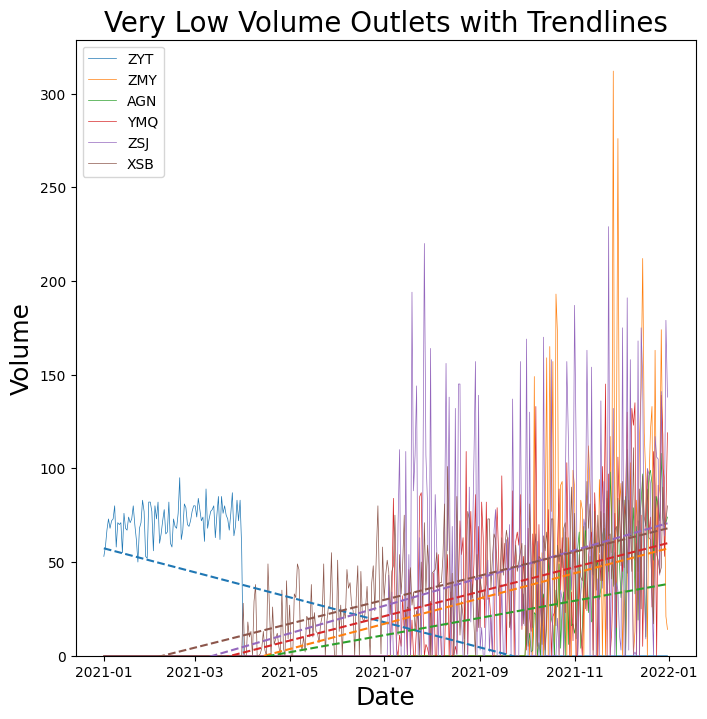

In [ ]:
period = 14
rolling_average = data.rolling(window=period).mean()

selected = ['ZYT', 'ZMY','AGN','YMQ','ZSJ','XSB']
print(data[selected].head())

plt.figure(figsize=(8, 8))
plt.plot(data[selected], linewidth=0.5)
plt.gca().set_prop_cycle(None)
for name in selected:
    x = np.arange(len(data[name]))
    z = np.polyfit(x, data[name], 1)
    trend = np.poly1d(z)
    plt.plot(data.index, trend(x), linestyle='--')
plt.ylim(ymin=0)
plt.xlabel('Date', fontsize=18)
plt.ylabel('Volume', fontsize=18)
plt.title('Very Low Volume Outlets with Trendlines', fontsize=20)
plt.legend(selected, loc=2)
plt.show()

In [ ]:
verylow = ['ZYT', 'ZMY','AGN','YMQ','ZSJ','XSB']
def get_line_plot():
    return data[verylow].hvplot.line(frame_width=600, frame_height=600, grid=True)

time_title = '## Time-Series'

time_row = pn.Row(
    pn.Column(time_title),
    get_line_plot()
)


time_row.servable()

Row
    [0] Column
        [0] Markdown(str)
    [1] HoloViews(NdOverlay, sizing_mode='fixed')

Closed outlet:ZYT
Opened outlet : ZMY, AGN,YMQ, ZSJ, XSB

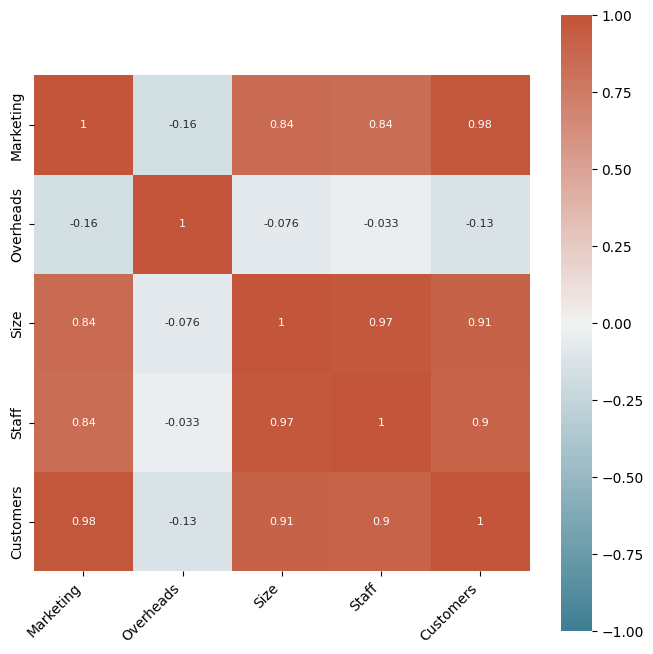

In [ ]:
data = pd.read_csv('https://raw.githubusercontent.com/ChrisWalshaw/DataViz/master/Data/001281690/OutletDailyCustomers.csv', index_col=0)

outlet_marketing_data = pd.read_csv('https://raw.githubusercontent.com/ChrisWalshaw/DataViz/master/Data/001281690/OutletMarketing.csv', index_col=0)
outlet_overheads_data = pd.read_csv('https://raw.githubusercontent.com/ChrisWalshaw/DataViz/master/Data/001281690/OutletOverheads.csv', index_col=0)
outlet_size_data = pd.read_csv('https://raw.githubusercontent.com/ChrisWalshaw/DataViz/master/Data/001281690/OutletSize.csv', index_col=0)
outlet_staff_data = pd.read_csv('https://raw.githubusercontent.com/ChrisWalshaw/DataViz/master/Data/001281690/OutletStaff.csv', index_col=0)

summary_data = pd.DataFrame(index=data.columns)
summary_data['Marketing'] = outlet_marketing_data.values
summary_data['Overheads'] = outlet_overheads_data.values
summary_data['Size'] = outlet_size_data.values
summary_data['Staff'] = outlet_staff_data.values
summary_data['Customers'] = data.sum().values


plt.figure(figsize=(8, 8))
corr = summary_data.corr()
ax = sns.heatmap(corr, vmin=-1, vmax=1, center=0, cmap=sns.diverging_palette(220, 20, n=200), square=True, annot=True,
                 annot_kws={"size": 8})
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, horizontalalignment='right')
plt.show()

In [ ]:
correlation_title = '## Correlations'

product_x = pn.widgets.Select(name='x-axis', options=list(summary_data.columns), width=200)
product_y = pn.widgets.Select(name='y-axis', options=list(summary_data.columns), width=200)

correlation_row = pn.Row(
    pn.Column(correlation_title, product_x, product_y),
    get_correlation_plots(product_x.value, product_y.value)
)

def update_correlation_row(event):
    correlation_row[1].object = get_correlation_plots(product_x.value, product_y.value)

product_x.param.watch(update_correlation_row, 'value')
product_y.param.watch(update_correlation_row, 'value')

correlation_row.servable()

Traceback (most recent call last):
 File "/usr/local/lib/python3.9/dist-packages/pyviz_comms/__init__.py", line 346, in _handle_msg
 self._on_msg(msg)
 File "/usr/local/lib/python3.9/dist-packages/panel/viewable.py", line 298, in _on_msg
 doc.unhold()
 File "/usr/local/lib/python3.9/dist-packages/bokeh/document/document.py", line 799, in unhold
 self.callbacks.unhold()
 File "/usr/local/lib/python3.9/dist-packages/bokeh/document/callbacks.py", line 396, in unhold
 self.trigger_on_change(event)
 File "/usr/local/lib/python3.9/dist-packages/bokeh/document/callbacks.py", line 373, in trigger_on_change
 invoke_with_curdoc(doc, event.callback_invoker)
 File "/usr/local/lib/python3.9/dist-packages/bokeh/document/callbacks.py", line 408, in invoke_with_curdoc
 return f()
 File "/usr/local/lib/python3.9/dist-packages/bokeh/util/callback_manager.py", line 191, in invoke
 callback(attr, old, new)
 File "/usr/local/lib/python3.9/dist-packages/panel/reactive.py", line 403, in _comm_change
 state._handle_exception(e)
 File "/usr/local/lib/python3.9/dist-packages/panel/io/state.py", line 408, in _handle_exception
 raise exception
 File "/usr/local/lib/python3.9/dist-packages/panel/reactive.py", line 401, in _comm_change
 self._schedule_change(doc, comm)
 File "/usr/local/lib/python3.9/dist-packages/panel/reactive.py", line 383, in _schedule_change
 self._change_event(doc)
 File "/usr/local/lib/python3.9/dist-packages/panel/reactive.py", line 379, in _change_event
 self._process_events(events)
 File "/usr/local/lib/python3.9/dist-packages/panel/reactive.py", line 318, in _process_events
 self.param.update(**self_events)
 File "/usr/local/lib/python3.9/dist-packages/param/parameterized.py", line 1902, in update
 self_._batch_call_watchers()
 File "/usr/local/lib/python3.9/dist-packages/param/parameterized.py", line 2063, in _batch_call_watchers
 self_._execute_watcher(watcher, events)
 File "/usr/local/lib/python3.9/dist-packages/param/parameterized.py", line 2025, in _execute_watcher
 watcher.fn(*args, **kwargs)
 File "<ipython-input-25-6c8926a5f8f2>", line 12, in update_correlation_row
 correlation_row[1].object = get_correlation_plots(product_x.value, product_y.value)
TypeError: get_correlation_plots() missing 1 required positional argument: 'date_range'

Row
    [0] Column
        [0] Markdown(str)
        [1] Select(name='x-axis', options=['Marketing', ...], value='Marketing', width=200)
        [2] Select(name='y-axis', options=['Marketing', ...], value='Marketing', width=200)
    [1] HoloViews(Layout)

2023-04-03 22:05:54,290 ERROR: panel.reactive - Callback failed for object named "y-axis" changing property {'value': 'Customers'} 
Traceback (most recent call last):
  File "/usr/local/lib/python3.9/dist-packages/panel/reactive.py", line 318, in _process_events
    self.param.update(**self_events)
  File "/usr/local/lib/python3.9/dist-packages/param/parameterized.py", line 1902, in update
    self_._batch_call_watchers()
  File "/usr/local/lib/python3.9/dist-packages/param/parameterized.py", line 2063, in _batch_call_watchers
    self_._execute_watcher(watcher, events)
  File "/usr/local/lib/python3.9/dist-packages/param/parameterized.py", line 2025, in _execute_watcher
    watcher.fn(*args, **kwargs)
  File "<ipython-input-25-6c8926a5f8f2>", line 12, in update_correlation_row
    correlation_row[1].object = get_correlation_plots(product_x.value, product_y.value)
TypeError: get_correlation_plots() missing 1 required positional argument: 'date_range'


heatmap correlation for daily customers


<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
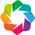

:HeatMap   [columns,index]   (value)

In [ ]:
plot = data.corr().hvplot.heatmap(
    frame_height=500, frame_width=500,
    title='Daily Outlet visits correlations',
    rot=90, cmap='coolwarm'  # see http://holoviews.org/user_guide/Colormaps.html
).opts(invert_yaxis=True, clim=(-1, 1))
# hvplot.show(plot)
hv.extension('bokeh')
plot

scatter plot for high volume data

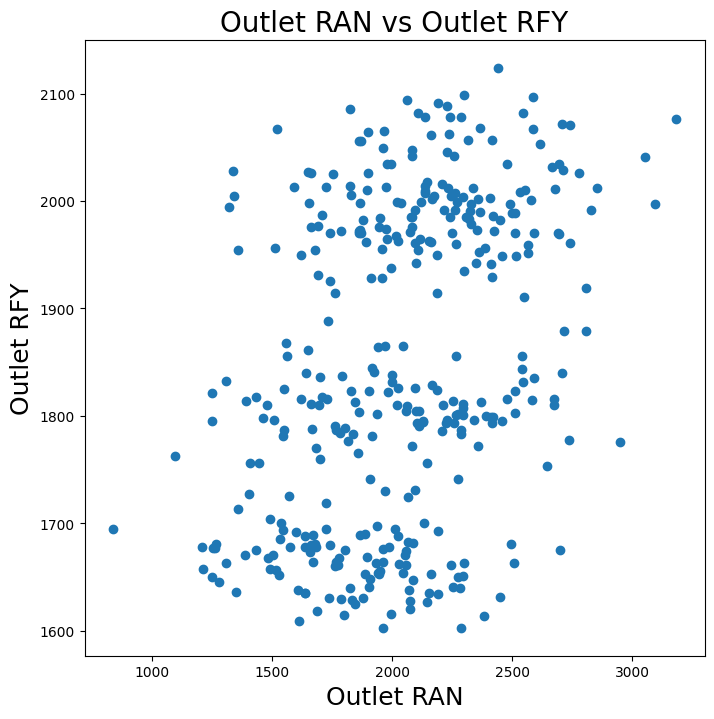

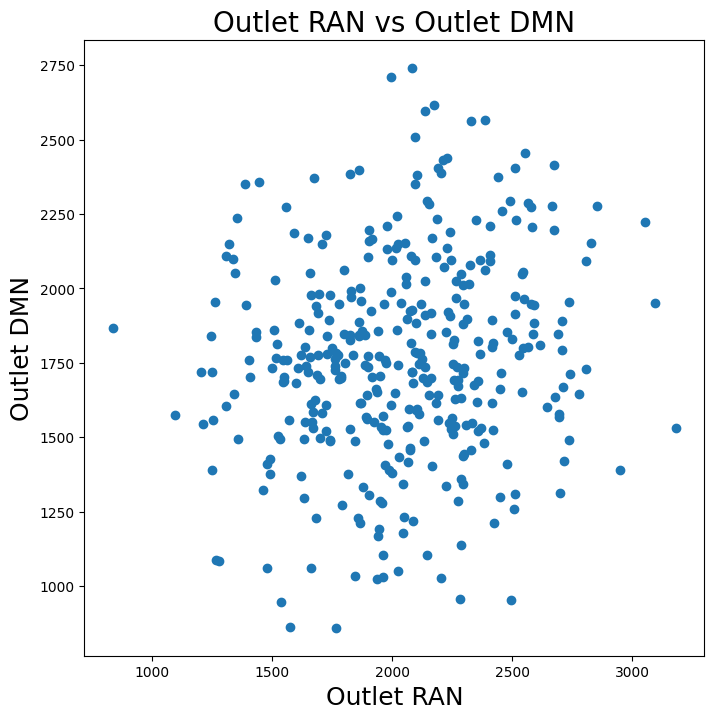

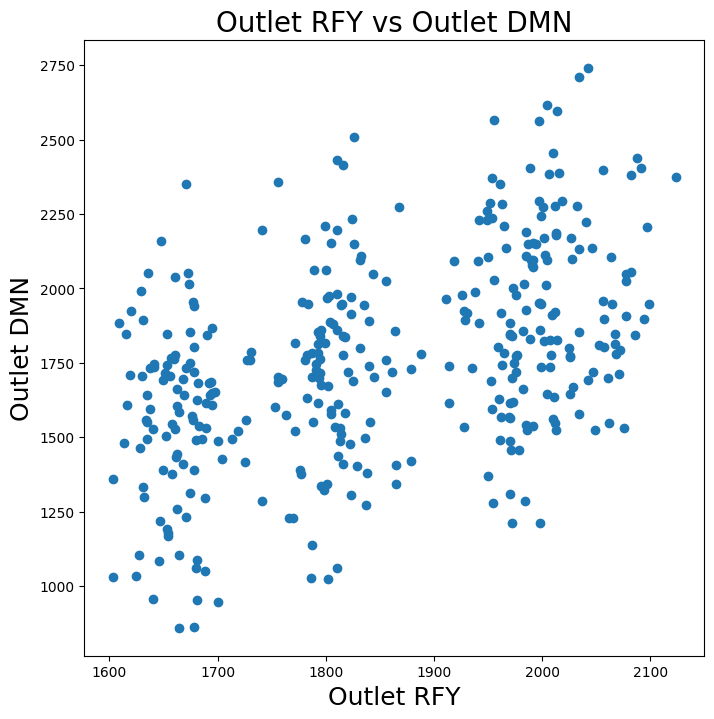

In [ ]:
high = ['RAN', 'RFY', 'DMN']

for i, name_i in enumerate(high):
    for j in range(i + 1, len(high)):
        name_j = high[j]
        plt.figure(figsize=(8, 8))
        plt.scatter(data[name_i], data[name_j])
        plt.title('Outlet ' + name_i + ' vs Outlet ' + name_j, fontsize=20)
        plt.xlabel('Outlet ' + name_i, fontsize=18)
        plt.ylabel('Outlet ' + name_j, fontsize=18)
        plt.show()


scatter plot for low volume data




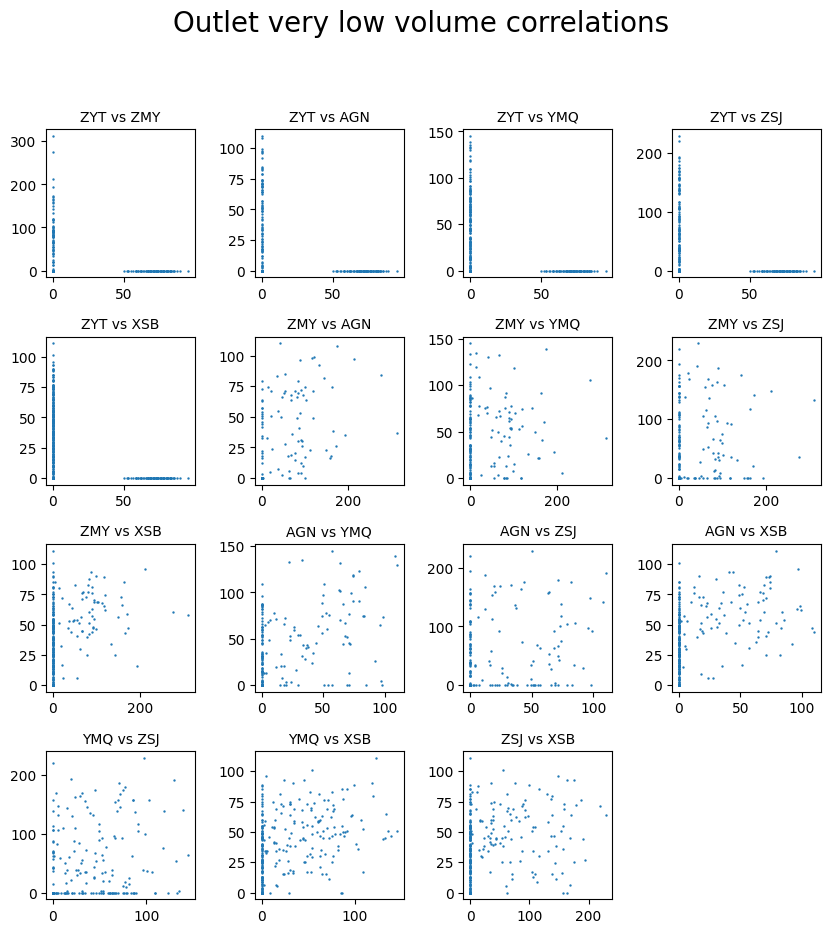

In [ ]:
low = ['ZYT', 'ZMY','AGN','YMQ','ZSJ','XSB']

counter = 1
fig = plt.figure(figsize=(10, 10))
fig.suptitle('Outlet very low volume correlations', fontsize=20, position=(0.5, 1.0))
plt.subplots_adjust(wspace=0.4, hspace=0.4)
for i, name_i in enumerate(selected):
    for j in range(i + 1, len(selected)):
        name_j = selected[j]
        sub = fig.add_subplot(4, 4, counter)
        sub.set_title(name_i + ' vs ' + name_j, fontsize=10)
        sub.scatter(data[name_i], data[name_j], s=0.5)
        counter += 1
plt.show()

Creation of subplot of histograms for distribution of 45 outlets

Date
2021-01-01    15189
2021-01-02    14561
2021-01-03    13255
2021-01-04    12764
2021-01-05    12083
              ...  
2021-12-27    12149
2021-12-28    11978
2021-12-29    13369
2021-12-30    14907
2021-12-31    14995
Length: 365, dtype: int64
15 bins


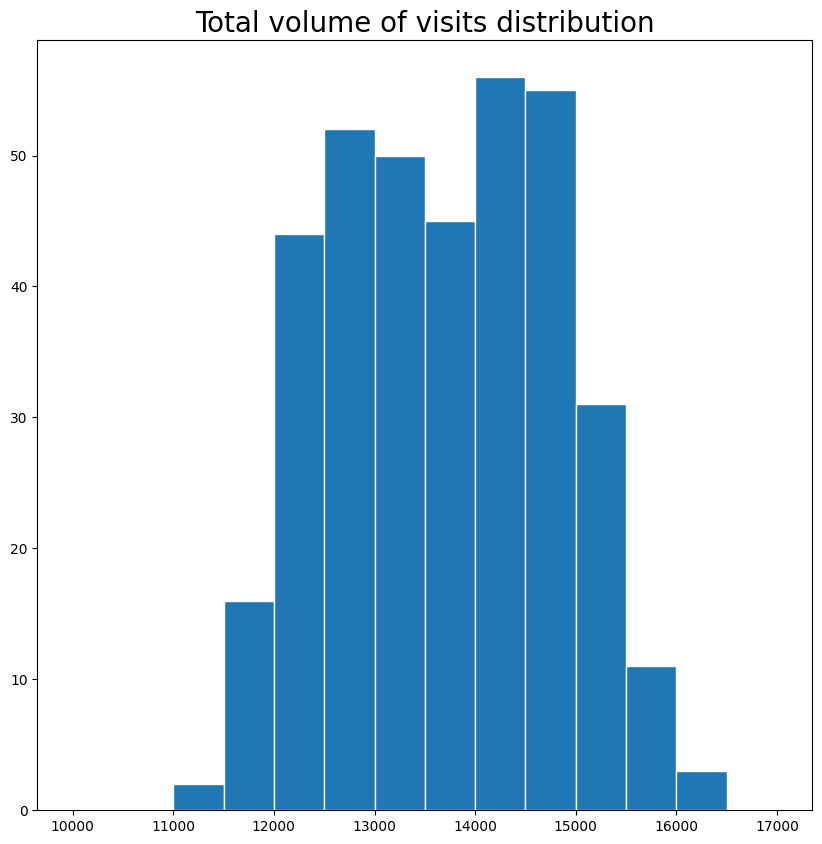

In [ ]:
print(data.sum(axis=1))

x_min = 10000
x_max = 17000
bin_width = 500

n_bins = int((bin_width + x_max - x_min) / bin_width)
print(str(n_bins) + ' bins')
bins = [(x_min + x * (bin_width + x_max - x_min) / n_bins) for x in range(int(n_bins))]

plt.figure(figsize=(10, 10))
plt.hist(data.sum(axis=1), bins, edgecolor='w')
plt.title('Total volume of visits distribution', fontsize=20)
plt.show()

High volume histogram


7 bins


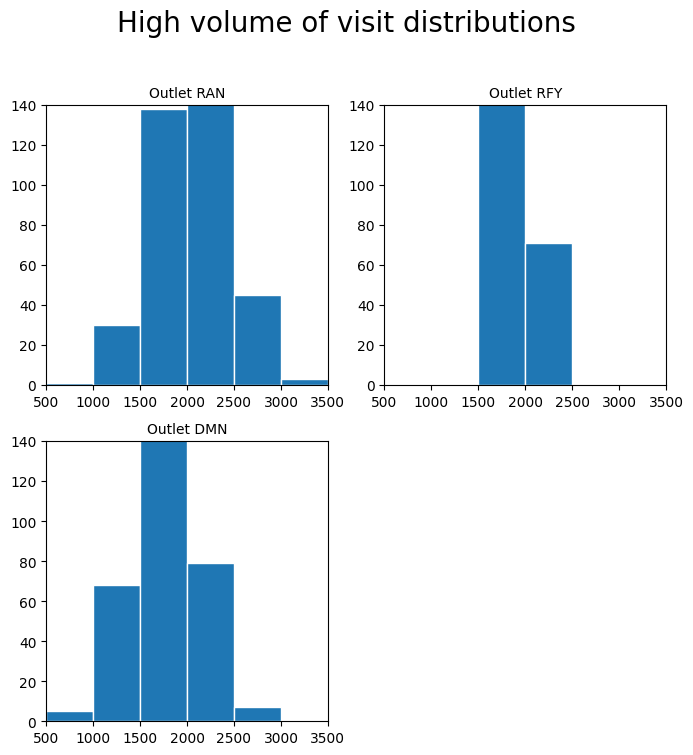

In [ ]:
high = ['RAN', 'RFY', 'DMN' ]
print( )
x_min = 500
x_max = 3500
bin_width = 500

n_bins = int((bin_width + x_max - x_min) / bin_width)
print(str(n_bins) + ' bins')
bins = [(x_min + x * (bin_width + x_max - x_min) / n_bins) for x in range(int(n_bins))]

fig = plt.figure(figsize=(8, 8))
fig.suptitle('High volume of visit distributions', fontsize=20, position=(0.5, 1.0))
counter = 1
for name in high:
    sub = fig.add_subplot(2, 2, counter)
    sub.hist(data[name], bins, edgecolor='w')
    sub.set_title('Outlet ' + name, fontsize=10)
    sub.set_xlim(xmin=x_min, xmax=x_max)
    sub.set_ylim(ymin=0, ymax=140)
    counter += 1
# plt.subplots_adjust(wspace=0.4, hspace=0.4)
plt.show()

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
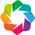

:NdOverlay   [Element]
   :Histogram   [DMN]   (DMN_count)

In [ ]:
high = ['RAN', 'RFY', 'DMN' ]

plot = data[high].hvplot.hist(
    frame_height=500, frame_width=500,
    xlabel='Customer visit', ylabel='Frequency',
    title='High Volume Outlets',
    alpha=0.5, muted_alpha=0, muted_fill_alpha=0, muted_line_alpha=0,
    tools=['pan', 'box_zoom', 'wheel_zoom', 'undo', 'redo', 'hover', 'save', 'reset']
)
#hvplot.show(plot)
hv.extension('bokeh')
plot

Line plot all sub plot for Outlet Daily customers

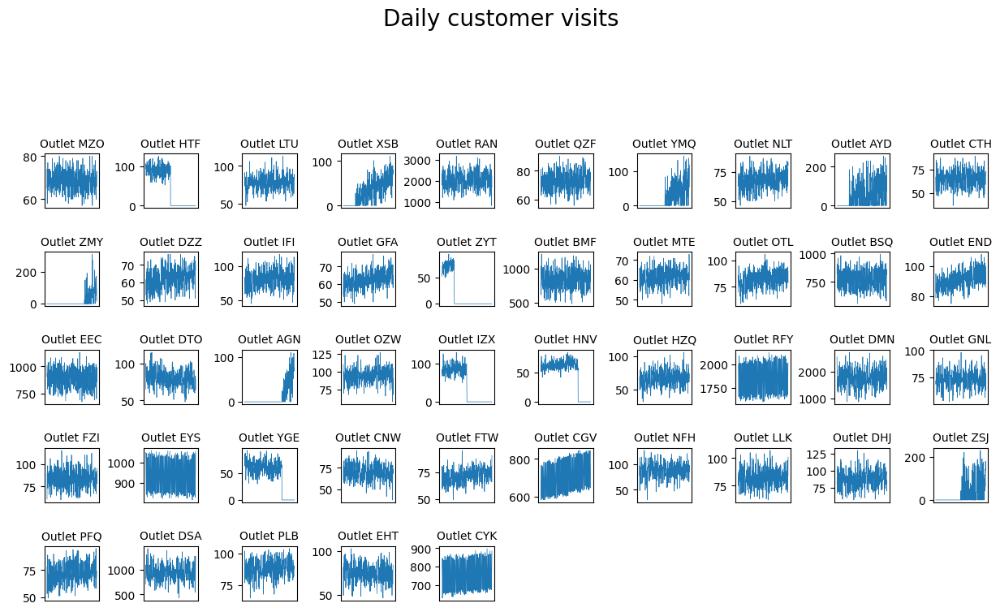

In [ ]:
counter = 1
fig = plt.figure(figsize=(15, 15))
fig.suptitle('Daily customer visits', fontsize=20, position=(0.5, 1.0))
for name in data.columns:
    sub = fig.add_subplot(10,10, counter)
    sub.set_title('Outlet ' + name, fontsize=10)
    sub.plot(data.index, data[name], linewidth=0.5)
    sub.axes.get_xaxis().set_ticks([])  # remove the x ticks
    counter += 1
plt.subplots_adjust(wspace=0.8, hspace=0.8)
plt.show()


Autocorrelation for high volume outlets

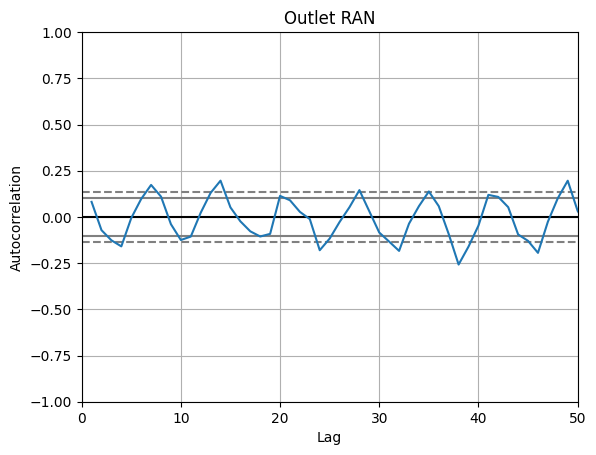

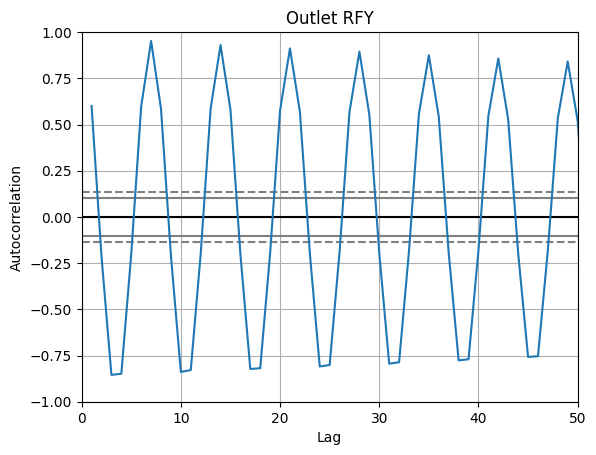

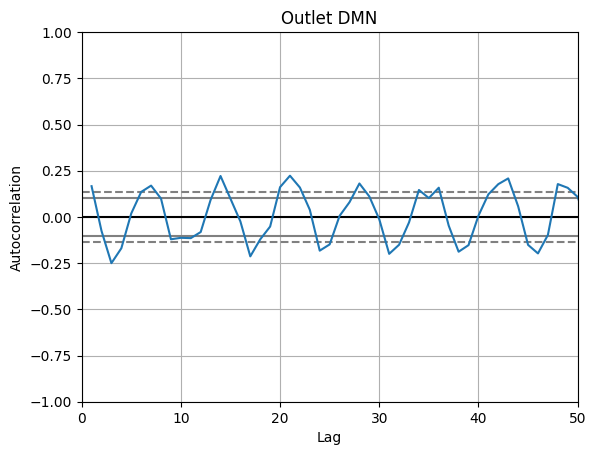

In [ ]:
high = ['RAN', 'RFY', 'DMN' ]

for name in high:
    pd.plotting.autocorrelation_plot(data[name])
    plt.xlim([0, 50]) # uncomment this line to zoom in
    plt.title('Outlet ' + name)
    plt.show()

Line plot decomposition quarterly for high volume outlets

<Figure size 1000x4000 with 0 Axes>

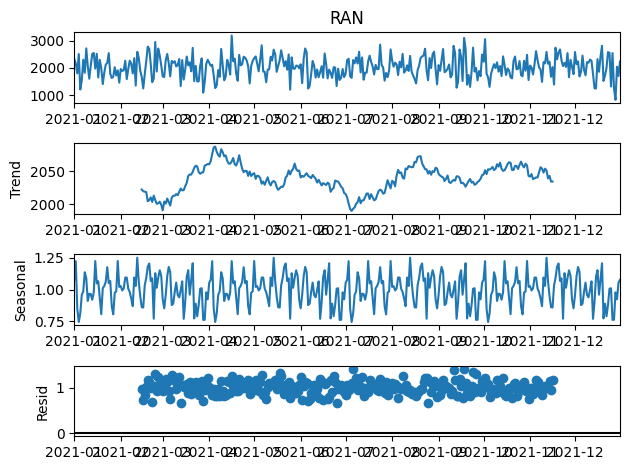

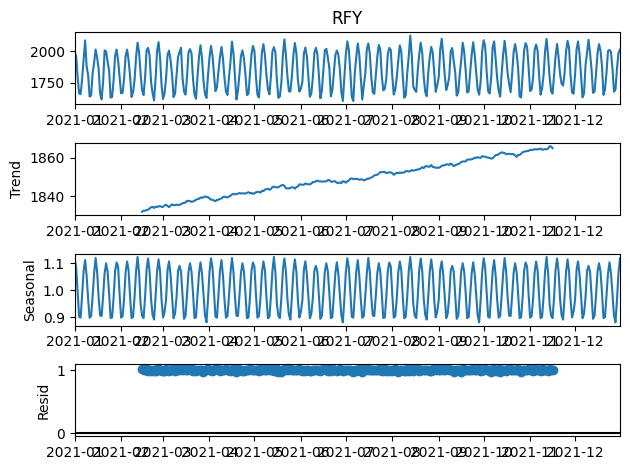

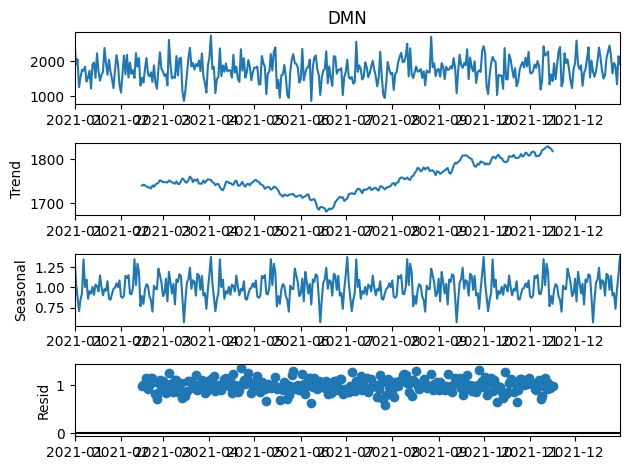

In [ ]:
high = ['RAN', 'RFY', 'DMN' ]
#dfhigh = data[high]

plt.figure(figsize=(10, 40))
for name in high:

    result = seasonal_decompose(data[name], model='multiplicative', period=91)
    result.plot()
   # plt.suptitle('Outlet ' + name, position=(0.5, 1.0))
    plt.show()


Radar plot high volume overlaid

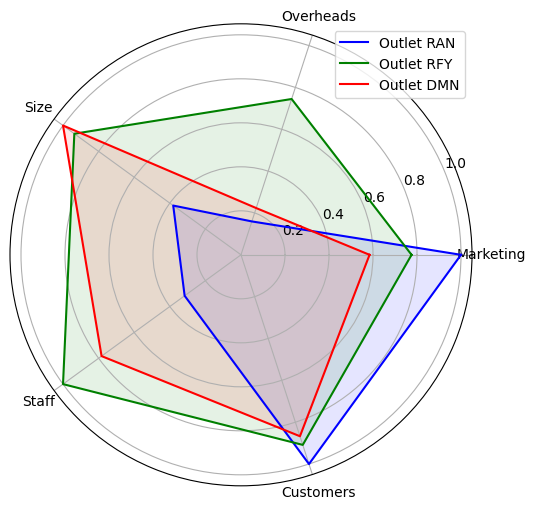

In [ ]:
normalised_data = summary_data / summary_data.max()
#print(normalised_data.head())
#high = ['RAN', 'RFY', 'DMN' ] # high volume
# medium = ['DSA', 'EYS', 'EEC', 'BMF', 'BSQ', 'CYK', 'CGV']  # medium volume
# low = ['ZYT', 'ZMY','AGN','YMQ','ZSJ','XSB']  # low volume
high = ['RAN', 'RFY', 'DMN' ]

n_attributes = len(normalised_data.columns)
angles = [n / float(n_attributes) * 2 * np.pi for n in range(n_attributes + 1)]
colours = ['b', 'g', 'r', 'c', 'm', 'y', 'k', 'w']
c = 0
plt.figure(figsize=(6, 6))
sub = plt.subplot(1, 1, 1, polar=True)
title='High Volume Outlets',
for name in high:
    values = normalised_data.loc[[name]].values.flatten().tolist()
    values += values[:1]
    sub.plot(angles, values, colours[c % len(colours)], label='Outlet ' + name)
    sub.fill(angles, values, colours[c % len(colours)], alpha=0.1)
    sub.set_ylim(ymax=1.05)
    sub.set_yticks([0.2, 0.4, 0.6, 0.8, 1.0])
    sub.set_xticks(angles[0:-1])
    sub.set_xticklabels(normalised_data.columns)
    c += 1
plt.legend(loc=1)
plt.show()

Radar plot medium volume overlaid

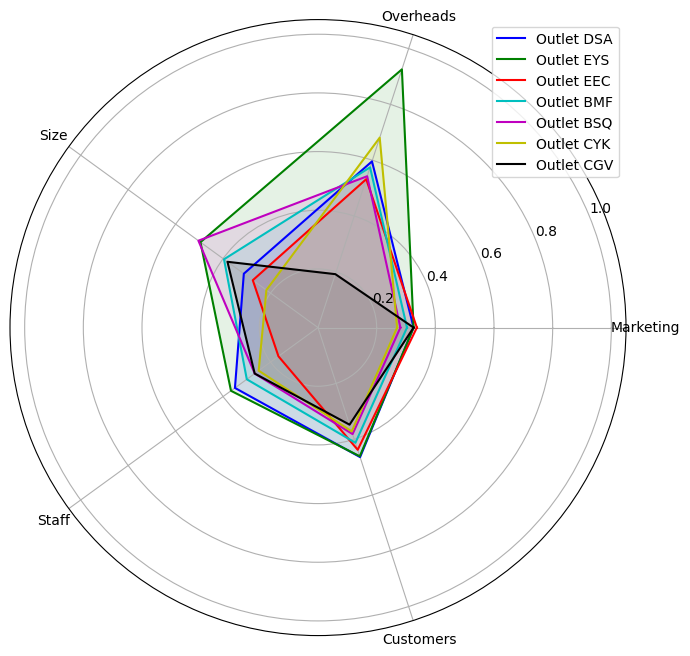

In [ ]:
normalised_data = summary_data / summary_data.max()
#print(normalised_data.head())
#high = ['RAN', 'RFY', 'DMN' ] # high volume
# medium = ['DSA', 'EYS', 'EEC', 'BMF', 'BSQ', 'CYK', 'CGV']  # medium volume
# low = ['ZYT', 'ZMY','AGN','YMQ','ZSJ','XSB']  # low volume
medium = ['DSA', 'EYS', 'EEC', 'BMF', 'BSQ', 'CYK', 'CGV']

n_attributes = len(normalised_data.columns)
angles = [n / float(n_attributes) * 2 * np.pi for n in range(n_attributes + 1)]
colours = ['b', 'g', 'r', 'c', 'm', 'y', 'k', 'w']
c = 0
plt.figure(figsize=(8, 8))
sub = plt.subplot(1, 1, 1, polar=True)
for name in medium:
    values = normalised_data.loc[[name]].values.flatten().tolist()
    values += values[:1]
    sub.plot(angles, values, colours[c % len(colours)], label='Outlet ' + name)
    sub.fill(angles, values, colours[c % len(colours)], alpha=0.1)
    sub.set_ylim(ymax=1.05)
    sub.set_yticks([0.2, 0.4, 0.6, 0.8, 1.0])
    sub.set_xticks(angles[0:-1])
    sub.set_xticklabels(normalised_data.columns)
    c += 1
plt.legend(loc=1)
plt.show()